**Setup**

In [5]:
!pip install prophet

In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from prophet import Prophet

**Load Dataset**

In [2]:
url = '/content/coin_Bitcoin.csv'
data = pd.read_csv(url)

data.head()

,SNo,Name,Symbol,Date,High,Low,Open,Close,Volume,Marketcap
0,1,Bitcoin,BTC,2013-04-29 23:59:59,147.488007,134.000000,134.444000,144.539993,0.0,1.603769e+09
1,2,Bitcoin,BTC,2013-04-30 23:59:59,146.929993,134.050003,144.000000,139.000000,0.0,1.542813e+09
2,3,Bitcoin,BTC,2013-05-01 23:59:59,139.889999,107.720001,139.000000,116.989998,0.0,1.298955e+09
3,4,Bitcoin,BTC,2013-05-02 23:59:59,125.599998,92.281898,116.379997,105.209999,0.0,1.168517e+09
4,5,Bitcoin,BTC,2013-05-03 23:59:59,108.127998,79.099998,106.250000,97.750000,0.0,1.085995e+09


In [3]:
# Display basic information about the dataset
data.info()

# Display summary statistics
data.describe()

# Check for missing values
data.isnull().sum()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2991 entries, 0 to 2990
Data columns (total 10 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   SNo        2991 non-null   int64  
 1   Name       2991 non-null   object 
 2   Symbol     2991 non-null   object 
 3   Date       2991 non-null   object 
 4   High       2991 non-null   float64
 5   Low        2991 non-null   float64
 6   Open       2991 non-null   float64
 7   Close      2991 non-null   float64
 8   Volume     2991 non-null   float64
 9   Marketcap  2991 non-null   float64
dtypes: float64(6), int64(1), object(3)
memory usage: 233.8+ KB


SNo          0
Name         0
Symbol       0
Date         0
High         0
Low          0
Open         0
Close        0
Volume       0
Marketcap    0
dtype: int64

In [8]:
# Rename the columns for Prophet
data = data.rename(columns={'Date': 'ds', 'High': 'y'})
print(data.head())


   SNo     Name Symbol                   ds        High         Low  \
0    1  Bitcoin    BTC  2013-04-29 23:59:59  147.488007  134.000000   
1    2  Bitcoin    BTC  2013-04-30 23:59:59  146.929993  134.050003   
2    3  Bitcoin    BTC  2013-05-01 23:59:59  139.889999  107.720001   
3    4  Bitcoin    BTC  2013-05-02 23:59:59  125.599998   92.281898   
4    5  Bitcoin    BTC  2013-05-03 23:59:59  108.127998   79.099998   

         Open           y  Volume     Marketcap  
0  134.444000  144.539993     0.0  1.603769e+09  
1  144.000000  139.000000     0.0  1.542813e+09  
2  139.000000  116.989998     0.0  1.298955e+09  
3  116.379997  105.209999     0.0  1.168517e+09  
4  106.250000   97.750000     0.0  1.085995e+09  


**Exploratory Data Analysis (EDA):**

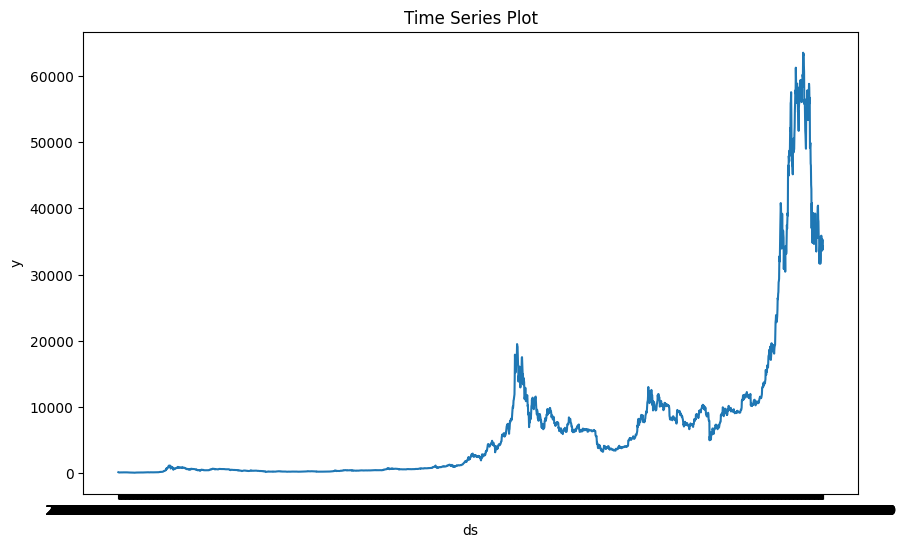

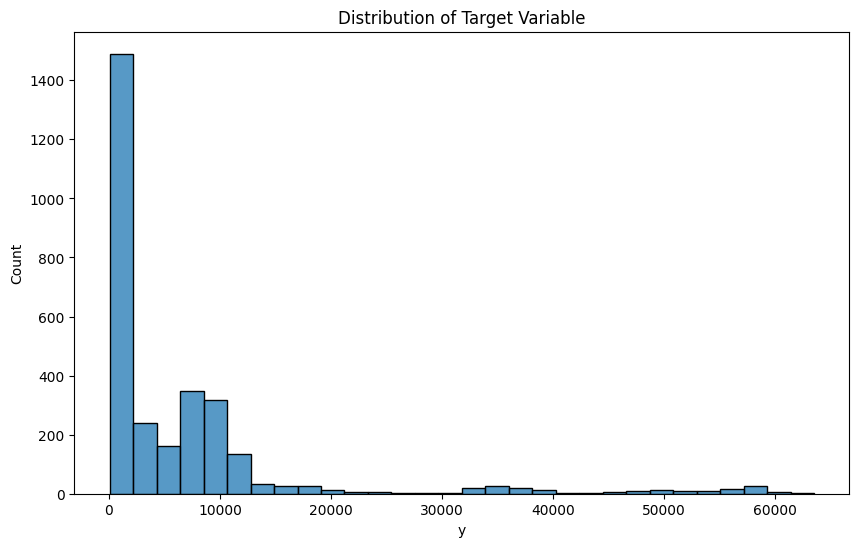

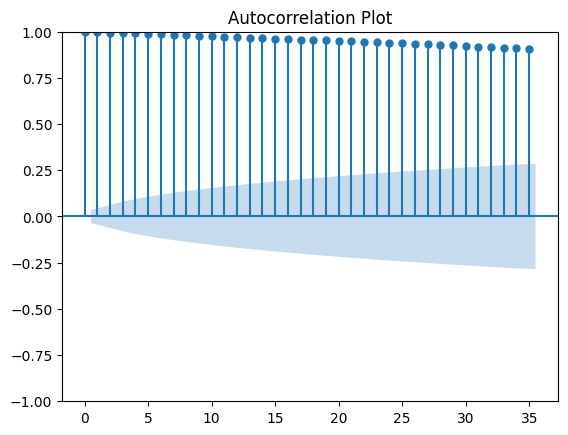

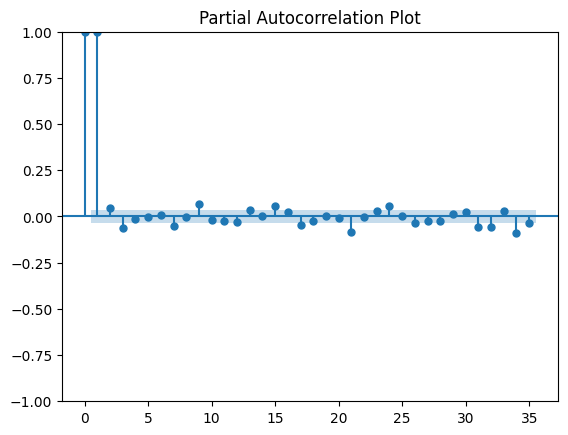

In [11]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot time series data
plt.figure(figsize=(10,6))
plt.plot(data['ds'], data['y'])
plt.title('Time Series Plot')
plt.xlabel('ds')
plt.ylabel('y')
plt.show()

# Plot distribution of target variable
plt.figure(figsize=(10,6))
sns.histplot(data['y'], bins=30)
plt.title('Distribution of Target Variable')
plt.show()

# Plot autocorrelation and partial autocorrelation plots
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

plot_acf(data['y'])
plt.title('Autocorrelation Plot')
plt.show()

plot_pacf(data['y'])
plt.title('Partial Autocorrelation Plot')
plt.show()


**Modelling**

In [12]:
model = Prophet()
model.fit(data)

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpcjn_x951/y0wuf5vf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpcjn_x951/yb_3cgxf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=14193', 'data', 'file=/tmp/tmpcjn_x951/y0wuf5vf.json', 'init=/tmp/tmpcjn_x951/yb_3cgxf.json', 'output', 'file=/tmp/tmpcjn_x951/prophet_modeluklyykw6/prophet_model-20231126054212.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
05:42:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
05:42:13 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


In [13]:
future = model.make_future_dataframe(periods=365)
future.tail()

,ds
3351,2022-07-02 23:59:59
3352,2022-07-03 23:59:59
3353,2022-07-04 23:59:59
3354,2022-07-05 23:59:59
3355,2022-07-06 23:59:59


In [14]:
forecast = model.predict(future)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
3351,2022-07-02 23:59:59,66294.489051,59450.209162,73577.013088
3352,2022-07-03 23:59:59,66360.599175,59184.708913,73500.169919
3353,2022-07-04 23:59:59,66465.413743,59465.090758,73849.807294
3354,2022-07-05 23:59:59,66565.424804,59708.841730,73385.179784
3355,2022-07-06 23:59:59,66691.258587,59722.920027,73712.182230


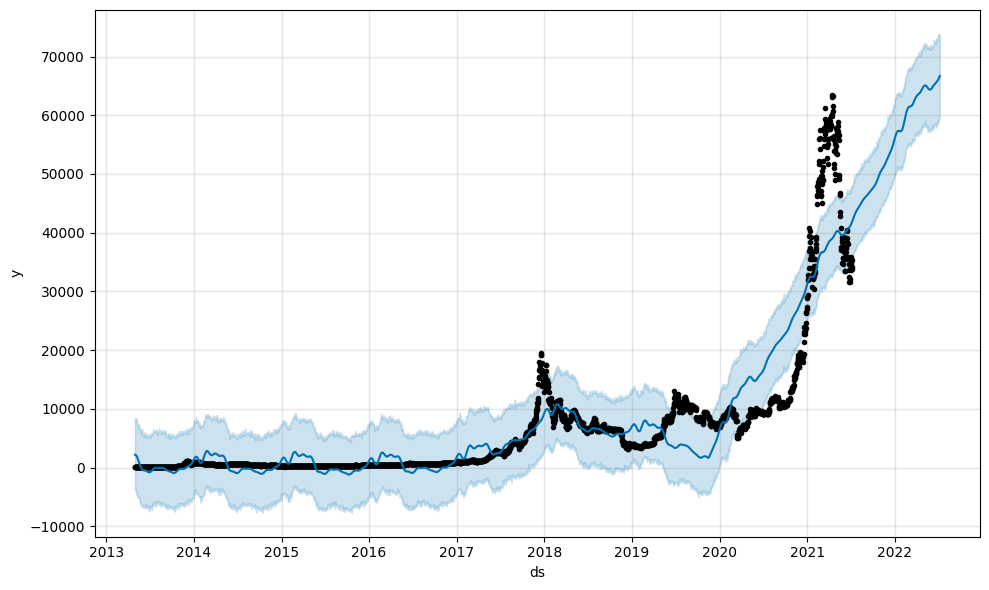

In [15]:
fig1 = model.plot(forecast)

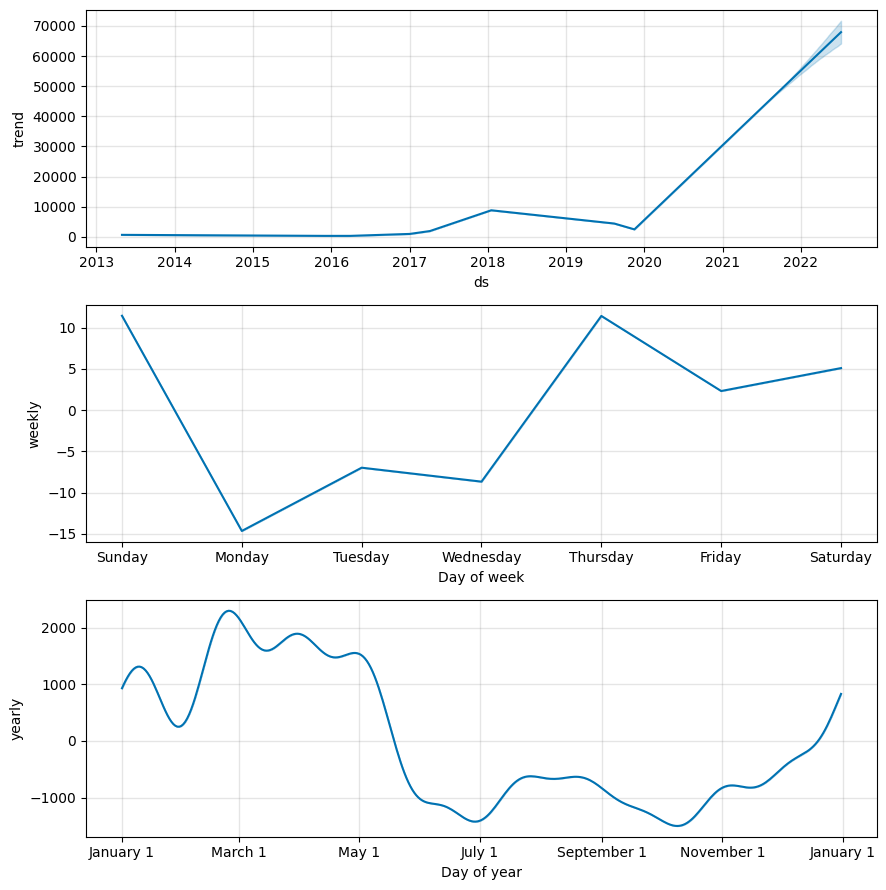

In [16]:
fig2 = model.plot_components(forecast)

In [17]:
from prophet.plot import plot_plotly, plot_components_plotly

plot_plotly(model, forecast)

In [18]:
plot_components_plotly(model, forecast)